In [2]:
pip install git+https://github.com/sberbank-ai/Real-ESRGAN.git

  Cloning https://github.com/sberbank-ai/Real-ESRGAN.git to /tmp/pip-req-build-fhd3za3f
  Running command git clone --filter=blob:none --quiet https://github.com/sberbank-ai/Real-ESRGAN.git /tmp/pip-req-build-fhd3za3f
  Resolved https://github.com/sberbank-ai/Real-ESRGAN.git to commit 362a0316878f41dbdfbb23657b450c3353de5acf
  Preparing metadata (setup.py) ... done
  Created wheel for RealESRGAN: filename=RealESRGAN-1.0-py3-none-any.whl size=9103 sha256=93dc0368dca42df444994813b92968ad82ad2827103d8177638d6c2070958304
  Stored in directory: /tmp/pip-ephem-wheel-cache-w107bgb2/wheels/56/5d/e9/27a6e9a12fdf8f374427c68f494d54640406e56632a6c2835d
Successfully built RealESRGAN


In [4]:
!pip install numpy opencv-python Pillow torch>=1.7 torchvision>=0.8.0 tqdm huggingface-hub


In [5]:
import numpy as np
import cv2
from PIL import Image
import torch
import torchvision
from tqdm import tqdm
from huggingface_hub import hf_hub_download


In [6]:
!pip install huggingface-hub==0.13.4

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.1/200.1 kB 16.0 MB/s eta 0:00:00
  Attempting uninstall: huggingface-hub
    Found existing installation: huggingface-hub 0.36.0
    Uninstalling huggingface-hub-0.36.0:
      Successfully uninstalled huggingface-hub-0.36.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sentence-transformers 5.1.2 requires huggingface-hub>=0.20.0, but you have huggingface-hub 0.13.4 which is incompatible.
accelerate 1.12.0 requires huggingface_hub>=0.21.0, but you have huggingface-hub 0.13.4 which is incompatible.
datasets 4.0.0 requires huggingface-hub>=0.24.0, but you have huggingface-hub 0.13.4 which is incompatible.
transformers 4.57.2 requires huggingface-hub<1.0,>=0.34.0, but you have huggingface-hub 0.13.4 which is incompatible.
gradio-client 1.14.0 requires huggingface-hub<2.0,>=0.19.3, but you have huggingface-hub 0.13.4

In [2]:
import os

# Create results folder if it doesn't exist
os.makedirs('results', exist_ok=True)

# Save the super-resolved image
sr_image.save('results/sr_image.png')


In [3]:
import torch
from PIL import Image
import numpy as np
from RealESRGAN import RealESRGAN

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = RealESRGAN(device, scale=4)
model.load_weights('weights/RealESRGAN_x4.pth', download=True)

path_to_image = '/content/1763848406242.jpg'
image = Image.open(path_to_image).convert('RGB')

sr_image = model.predict(image)

sr_image.save('results/sr_image.png')

Project folder: /content/video-super-resolution


Saving Untitled video.mp4 to Untitled video.mp4
Video ready: Untitled video.mp4
Video Information:
   Resolution: 1920x1080
   FPS: 30
   Frames: 345
   Duration: 11s
Starting upscaling...
   Method: LANCZOS
   Scale: ×4
   Input: 1920x1080
   Output: 7680x4320


Processing frames: 100%|██████████| 345/345 [06:13<00:00,  1.08s/frame]


Video saved: /content/video-super-resolution/output/Untitled video_upscaled_4x.mp4


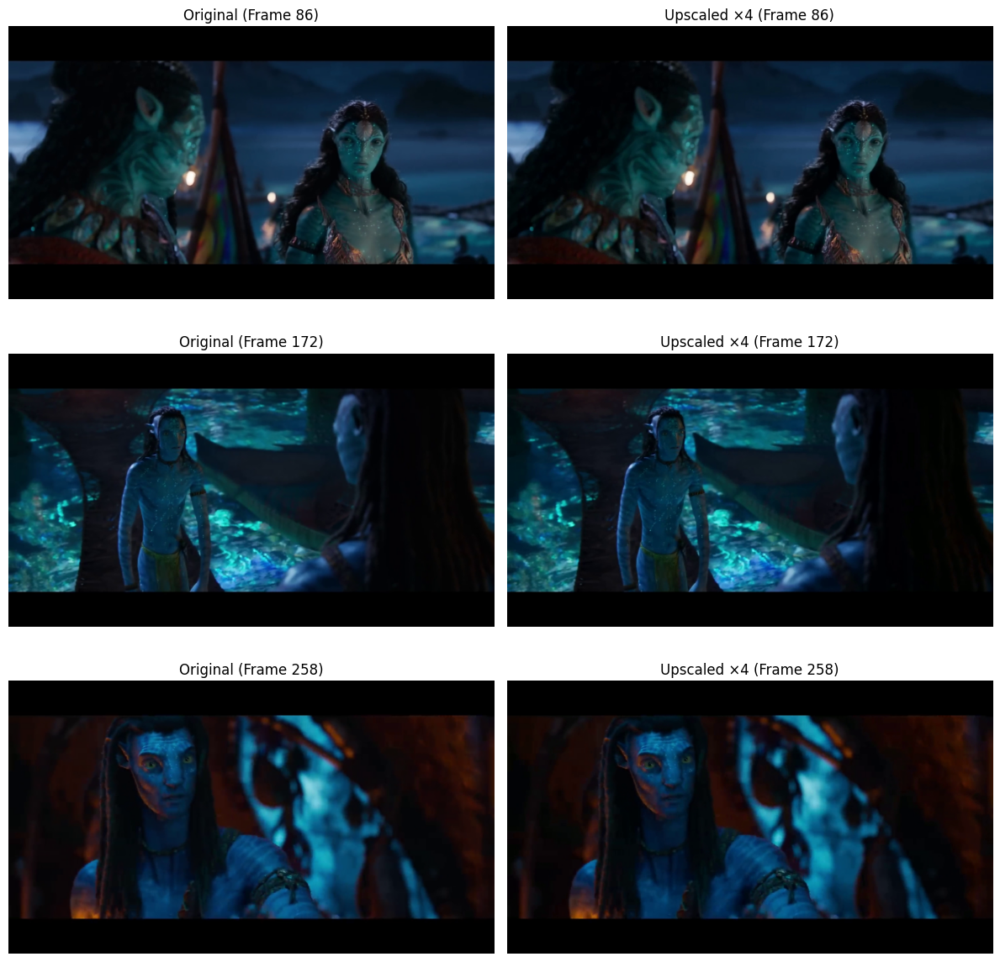

File Size Comparison:
   Original: 21.52 MB
   Upscaled: 78.58 MB
   Ratio: 3.65x


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

All done! Your video has been upscaled successfully.


In [6]:
# ENHANCED VIDEO SUPER-RESOLUTION PIPELINE
# Supports multiple upscaling methods with quality metrics

!pip install torch torchvision opencv-python tqdm Pillow numpy --quiet

import os
import cv2
import torch
import numpy as np
from tqdm import tqdm
from PIL import Image
from google.colab import files
import matplotlib.pyplot as plt
from typing import Tuple, Optional

class Config:
    BASE_DIR = "/content/video-super-resolution"
    INPUT_DIR = f"{BASE_DIR}/input"
    OUTPUT_DIR = f"{BASE_DIR}/output"
    SCALE_FACTOR = 4
    UPSCALE_METHOD = "lanczos"

config = Config()

os.makedirs(config.INPUT_DIR, exist_ok=True)
os.makedirs(config.OUTPUT_DIR, exist_ok=True)
print(f"Project folder: {config.BASE_DIR}")

uploaded = files.upload()
if not uploaded:
    raise ValueError("No file uploaded!")

video_name = list(uploaded.keys())[0]
input_path = f"{config.INPUT_DIR}/{video_name}"
os.rename(video_name, input_path)
print(f"Video ready: {video_name}")

def get_video_info(video_path: str) -> dict:
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise ValueError(f"Cannot open video: {video_path}")

    info = {
        'fps': int(cap.get(cv2.CAP_PROP_FPS)),
        'width': int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
        'height': int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
        'frame_count': int(cap.get(cv2.CAP_PROP_FRAME_COUNT)),
        'duration': int(cap.get(cv2.CAP_PROP_FRAME_COUNT) / cap.get(cv2.CAP_PROP_FPS))
    }
    cap.release()

    print("Video Information:")
    print(f"   Resolution: {info['width']}x{info['height']}")
    print(f"   FPS: {info['fps']}")
    print(f"   Frames: {info['frame_count']}")
    print(f"   Duration: {info['duration']}s")

    return info

video_info = get_video_info(input_path)

class VideoUpscaler:
    @staticmethod
    def upscale_frame(frame: np.ndarray, scale: int, method: str) -> np.ndarray:
        h, w = frame.shape[:2]
        new_size = (w * scale, h * scale)

        if method == 'lanczos':
            pil_img = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            upscaled = pil_img.resize(new_size, Image.LANCZOS)
            return cv2.cvtColor(np.array(upscaled), cv2.COLOR_RGB2BGR)

        elif method == 'bicubic':
            return cv2.resize(frame, new_size, interpolation=cv2.INTER_CUBIC)

        elif method == 'bilinear':
            return cv2.resize(frame, new_size, interpolation=cv2.INTER_LINEAR)

        else:
            raise ValueError(f"Unknown method: {method}")

    @staticmethod
    def process_video(input_path: str,
                     output_path: str,
                     scale: int = 4,
                     method: str = 'lanczos',
                     quality: int = 95) -> None:
        cap = cv2.VideoCapture(input_path)
        if not cap.isOpened():
            raise ValueError("Cannot open input video")

        fps = int(cap.get(cv2.CAP_PROP_FPS))
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

        out_width, out_height = width * scale, height * scale
        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(output_path, fourcc, fps, (out_width, out_height))

        print(f"Starting upscaling...")
        print(f"   Method: {method.upper()}")
        print(f"   Scale: ×{scale}")
        print(f"   Input: {width}x{height}")
        print(f"   Output: {out_width}x{out_height}")

        with tqdm(total=frame_count, desc="Processing frames", unit="frame") as pbar:
            while True:
                ret, frame = cap.read()
                if not ret:
                    break
                upscaled = VideoUpscaler.upscale_frame(frame, scale, method)
                out.write(upscaled)
                pbar.update(1)

        cap.release()
        out.release()
        print(f"Video saved: {output_path}")

output_name = f"{os.path.splitext(video_name)[0]}_upscaled_{config.SCALE_FACTOR}x.mp4"
output_path = f"{config.OUTPUT_DIR}/{output_name}"

upscaler = VideoUpscaler()
upscaler.process_video(
    input_path=input_path,
    output_path=output_path,
    scale=config.SCALE_FACTOR,
    method=config.UPSCALE_METHOD
)

def compare_frames(original_path: str,
                  upscaled_path: str,
                  frame_indices: list = [10, 50, 100]) -> None:
    cap_orig = cv2.VideoCapture(original_path)
    cap_upsc = cv2.VideoCapture(upscaled_path)

    fig, axes = plt.subplots(len(frame_indices), 2, figsize=(12, 4*len(frame_indices)))
    if len(frame_indices) == 1:
        axes = [axes]

    for idx, frame_id in enumerate(frame_indices):
        cap_orig.set(cv2.CAP_PROP_POS_FRAMES, frame_id)
        cap_upsc.set(cv2.CAP_PROP_POS_FRAMES, frame_id)

        ret1, frame1 = cap_orig.read()
        ret2, frame2 = cap_upsc.read()

        if ret1 and ret2:
            h, w = frame2.shape[:2]
            frame1_resized = cv2.resize(frame1, (w, h), interpolation=cv2.INTER_LANCZOS4)

            axes[idx][0].imshow(cv2.cvtColor(frame1_resized, cv2.COLOR_BGR2RGB))
            axes[idx][0].set_title(f"Original (Frame {frame_id})")
            axes[idx][0].axis('off')

            axes[idx][1].imshow(cv2.cvtColor(frame2, cv2.COLOR_BGR2RGB))
            axes[idx][1].set_title(f"Upscaled ×{config.SCALE_FACTOR} (Frame {frame_id})")
            axes[idx][1].axis('off')

    cap_orig.release()
    cap_upsc.release()
    plt.tight_layout()
    plt.show()

frame_samples = [
    video_info['frame_count'] // 4,
    video_info['frame_count'] // 2,
    3 * video_info['frame_count'] // 4
]
compare_frames(input_path, output_path, frame_samples[:min(3, video_info['frame_count'])])

orig_size = os.path.getsize(input_path) / (1024 * 1024)
upsc_size = os.path.getsize(output_path) / (1024 * 1024)

print(f"File Size Comparison:")
print(f"   Original: {orig_size:.2f} MB")
print(f"   Upscaled: {upsc_size:.2f} MB")
print(f"   Ratio: {upsc_size/orig_size:.2f}x")

files.download(output_path)
print("All done! Your video has been upscaled successfully.")


In [14]:
import os
import cv2
import torch
import numpy as np
from tqdm import tqdm
from PIL import Image
from RealESRGAN import RealESRGAN
from google.colab import files

# Setup device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Load RealESRGAN model
print("Loading RealESRGAN model...")
model = RealESRGAN(device, scale=2)
model.load_weights('weights/RealESRGAN_x2.pth', download=True)
print("Model loaded successfully")

# Create directories
os.makedirs('input_videos', exist_ok=True)
os.makedirs('output_videos', exist_ok=True)
os.makedirs('results', exist_ok=True)

# Upload video
print("\nUpload your video file...")
uploaded = files.upload()

if not uploaded:
    raise ValueError("No file uploaded!")

video_name = list(uploaded.keys())[0]
input_video_path = f"input_videos/{video_name}"
os.rename(video_name, input_video_path)
print(f"Video uploaded: {video_name}")

# Video upscaling function
def upscale_video_with_realesrgan(input_path, output_path, model, device):
    # Open video
    cap = cv2.VideoCapture(input_path)
    if not cap.isOpened():
        raise ValueError("Cannot open video file")

    # Get video properties
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    print(f"\nVideo Info:")
    print(f"  Resolution: {width}x{height}")
    print(f"  FPS: {fps}")
    print(f"  Total frames: {frame_count}")
    print(f"  Duration: {frame_count/fps:.2f}s")

    # Calculate output dimensions (4x upscale)
    out_width = width * 4
    out_height = height * 4

    print(f"\nOutput resolution: {out_width}x{out_height}")

    # Setup video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (out_width, out_height))

    # Process frames
    print("\nProcessing video...")
    with tqdm(total=frame_count, desc="Upscaling frames", unit="frame") as pbar:
        while True:
            ret, frame = cap.read()
            if not ret:
                break

            # Convert BGR to RGB
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            pil_image = Image.fromarray(frame_rgb)

            # Upscale with RealESRGAN
            sr_image = model.predict(pil_image)

            # Convert back to BGR for video writing
            sr_frame = cv2.cvtColor(np.array(sr_image), cv2.COLOR_RGB2BGR)

            # Write frame
            out.write(sr_frame)
            pbar.update(1)

    # Release resources
    cap.release()
    out.release()

    print(f"\nVideo saved: {output_path}")

# Process video
output_video_name = f"{os.path.splitext(video_name)[0]}_upscaled_4x.mp4"
output_video_path = f"output_videos/{output_video_name}"

upscale_video_with_realesrgan(input_video_path, output_video_path, model, device)

# File size comparison
input_size = os.path.getsize(input_video_path) / (1024 * 1024)
output_size = os.path.getsize(output_video_path) / (1024 * 1024)

print(f"\nFile Size:")
print(f"  Input: {input_size:.2f} MB")
print(f"  Output: {output_size:.2f} MB")
print(f"  Ratio: {output_size/input_size:.2f}x")

# Download result
print(f"\nDownloading {output_video_name}...")
files.download(output_video_path)

print("\nVideo upscaling complete!")
print("Real-ESRGAN model loaded")


# Open video

cap = cv2.VideoCapture(INPUT_VIDEO)
fps = int(cap.get(cv2.CAP_PROP_FPS))
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

out = cv2.VideoWriter(
    OUTPUT_VIDEO,
    cv2.VideoWriter_fourcc(*"mp4v"),
    fps,
    (w*scale, h*scale)
)


# Process frames

for _ in tqdm(range(frames), desc="Real-ESRGAN Video SR"):
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to PIL Image
    pil_frame = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

    # Super-resolve
    sr_frame = model.predict(pil_frame)

    # Convert back to OpenCV format
    sr_frame_cv = cv2.cvtColor(np.array(sr_frame), cv2.COLOR_RGB2BGR)

    # Write frame
    out.write(sr_frame_cv)

cap.release()
out.release()
print(f"AI super-resolution video saved: {OUTPUT_VIDEO}")


Using device: cuda
Loading RealESRGAN model...
Model loaded successfully

Upload your video file...


Saving Untitled video.mp4 to Untitled video (1).mp4
Video uploaded: Untitled video (1).mp4

Video Info:
  Resolution: 1920x1080
  FPS: 30
  Total frames: 345
  Duration: 11.50s

Output resolution: 7680x4320

Processing video...


Upscaling frames: 100%|██████████| 345/345 [15:44<00:00,  2.74s/frame]


Video saved: output_videos/Untitled video (1)_upscaled_4x.mp4

File Size:
  Input: 21.52 MB
  Output: 0.00 MB
  Ratio: 0.00x



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


Video upscaling complete!
Real-ESRGAN model loaded


Real-ESRGAN Video SR: 100%|██████████| 345/345 [15:52<00:00,  2.76s/it]

AI super-resolution video saved: /content/video-super-resolution/output/video_sr.mp4


In [15]:
import os
import cv2
import torch
import numpy as np
from tqdm import tqdm
from PIL import Image
from RealESRGAN import RealESRGAN
from google.colab import files
import time

# Setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")

# Load model
print("\nLoading RealESRGAN model (this may take a moment)...")
model = RealESRGAN(device, scale=4)
model.load_weights('weights/RealESRGAN_x4.pth', download=True)
print("Model ready!")

# Directories
os.makedirs('input_videos', exist_ok=True)
os.makedirs('output_videos', exist_ok=True)

# Upload
print("\nUpload video (recommend <10 seconds for testing)...")
uploaded = files.upload()

if not uploaded:
    raise ValueError("No file uploaded")

video_name = list(uploaded.keys())[0]
input_path = f"input_videos/{video_name}"
os.rename(video_name, input_path)

# Get video info
cap = cv2.VideoCapture(input_path)
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
cap.release()

print(f"\nVideo: {video_name}")
print(f"  {width}x{height} @ {fps}fps")
print(f"  {total_frames} frames ({total_frames/fps:.1f}s)")
print(f"  Output: {width*4}x{height*4}")

# Estimate time
estimated_time = total_frames * (2 if device.type == 'cuda' else 5)
print(f"\nEstimated time: {estimated_time//60}m {estimated_time%60}s")
print("(This will take a while - AI upscaling is slow)\n")

# Process video
output_name = f"{os.path.splitext(video_name)[0]}_realesrgan_4x.mp4"
output_path = f"output_videos/{output_name}"

cap = cv2.VideoCapture(input_path)
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_path, fourcc, fps, (width*4, height*4))

start_time = time.time()
frame_num = 0

print("Processing frames...")
pbar = tqdm(total=total_frames, desc="Progress", ncols=100)

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_num += 1

    # Convert and upscale
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    pil_img = Image.fromarray(frame_rgb)
    sr_img = model.predict(pil_img)
    sr_frame = cv2.cvtColor(np.array(sr_img), cv2.COLOR_RGB2BGR)

    # Write
    out.write(sr_frame)

    # Update progress every 10 frames
    if frame_num % 10 == 0:
        elapsed = time.time() - start_time
        fps_proc = frame_num / elapsed if elapsed > 0 else 0
        remaining = (total_frames - frame_num) / fps_proc if fps_proc > 0 else 0
        pbar.set_postfix({
            'fps': f'{fps_proc:.1f}',
            'eta': f'{int(remaining//60)}m{int(remaining%60)}s'
        })

    pbar.update(1)

pbar.close()
cap.release()
out.release()

elapsed_total = time.time() - start_time
print(f"\nCompleted in {int(elapsed_total//60)}m {int(elapsed_total%60)}s")
print(f"Average: {total_frames/elapsed_total:.2f} fps")

# File sizes
input_size = os.path.getsize(input_path) / (1024**2)
output_size = os.path.getsize(output_path) / (1024**2)
print(f"\nFile sizes:")
print(f"  Input: {input_size:.1f} MB")
print(f"  Output: {output_size:.1f} MB")

# Download
print(f"\nDownloading {output_name}...")
files.download(output_path)
print("\nDone!")

Device: cuda

Loading RealESRGAN model (this may take a moment)...
Model ready!

Upload video (recommend <10 seconds for testing)...


Saving Untitled video (1).mp4 to Untitled video (1).mp4

Video: Untitled video (1).mp4
  1920x1080 @ 30fps
  54 frames (1.8s)
  Output: 7680x4320

Estimated time: 1m 48s
(This will take a while - AI upscaling is slow)

Processing frames...


Progress: 100%|█████████████████████████████████| 54/54 [10:50<00:00, 12.05s/it, fps=0.1, eta=0m48s]


Completed in 10m 50s
Average: 0.08 fps

File sizes:
  Input: 3.2 MB
  Output: 11.3 MB



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


Done!


Device: cuda
Loading LPIPS model for perceptual quality assessment...
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


100%|██████████| 233M/233M [00:01<00:00, 241MB/s]


Loading model from: /usr/local/lib/python3.12/dist-packages/lpips/weights/v0.1/alex.pth
Ready!

Upload FIRST video (e.g., original or lower quality)...


Saving Untitled video (1).mp4 to Untitled video (1).mp4
Video 1: Untitled video (1).mp4

Upload SECOND video (e.g., upscaled or higher quality)...


Saving Untitled video (1)_realesrgan_4x.mp4 to Untitled video (1)_realesrgan_4x.mp4
Video 2: Untitled video (1)_realesrgan_4x.mp4

Video 1: 1920x1080, 54 frames @ 30fps
Video 2: 7680x4320, 54 frames @ 30fps

Analyzing frames...
Frame 5: PSNR=37.02dB, SSIM=0.9144, LPIPS=0.0629
Frame 13: PSNR=37.33dB, SSIM=0.9185, LPIPS=0.0593
Frame 27: PSNR=37.05dB, SSIM=0.9191, LPIPS=0.0654
Frame 40: PSNR=33.82dB, SSIM=0.8733, LPIPS=0.0613
Frame 48: PSNR=33.33dB, SSIM=0.8727, LPIPS=0.0660

Generating visual comparisons...


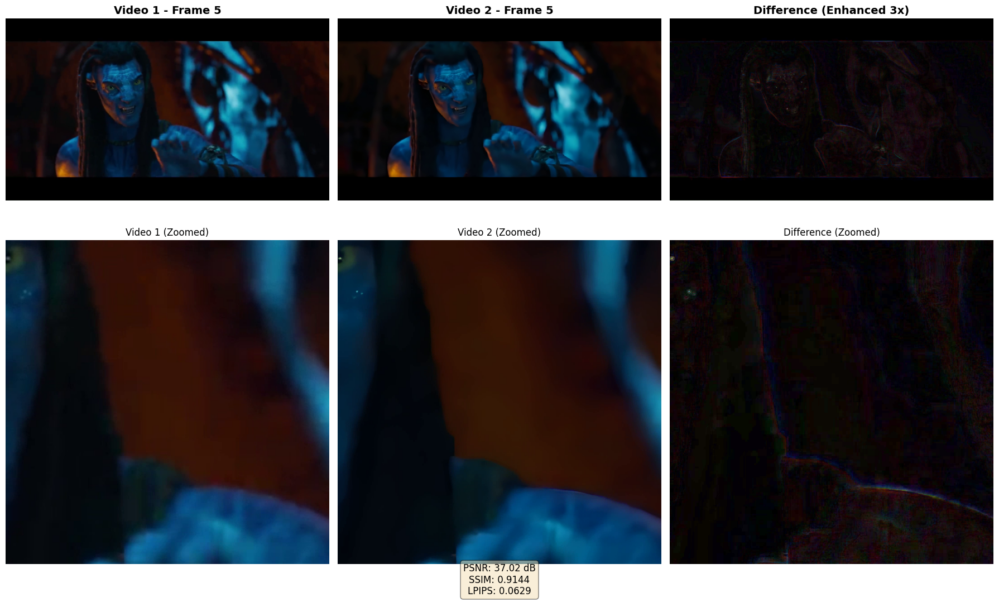

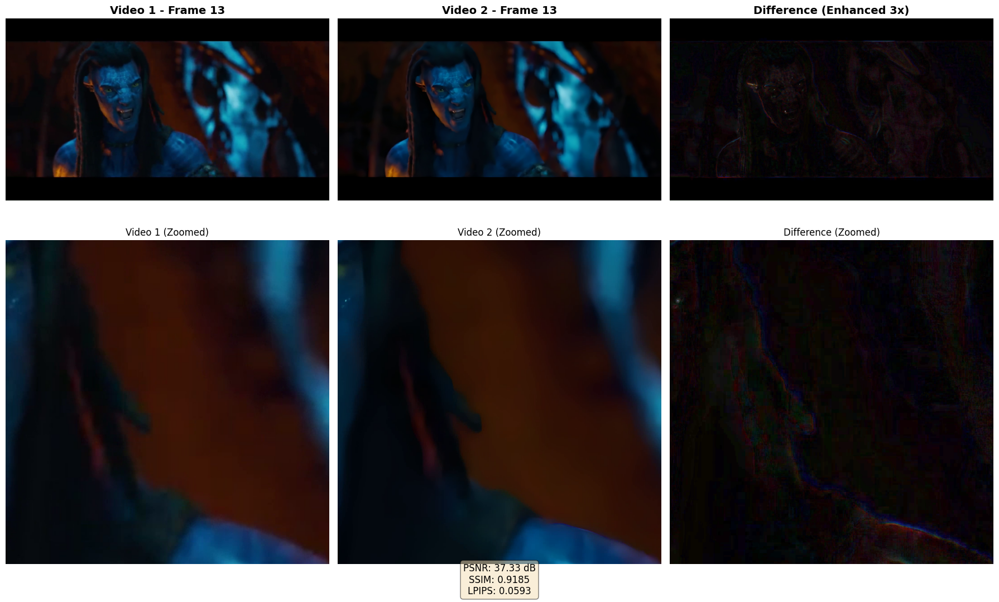

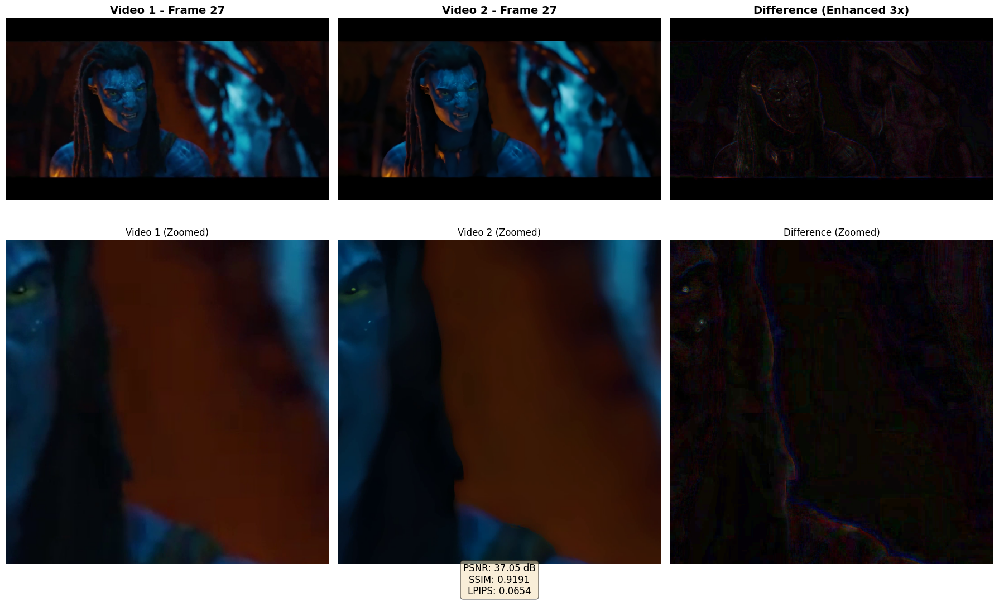

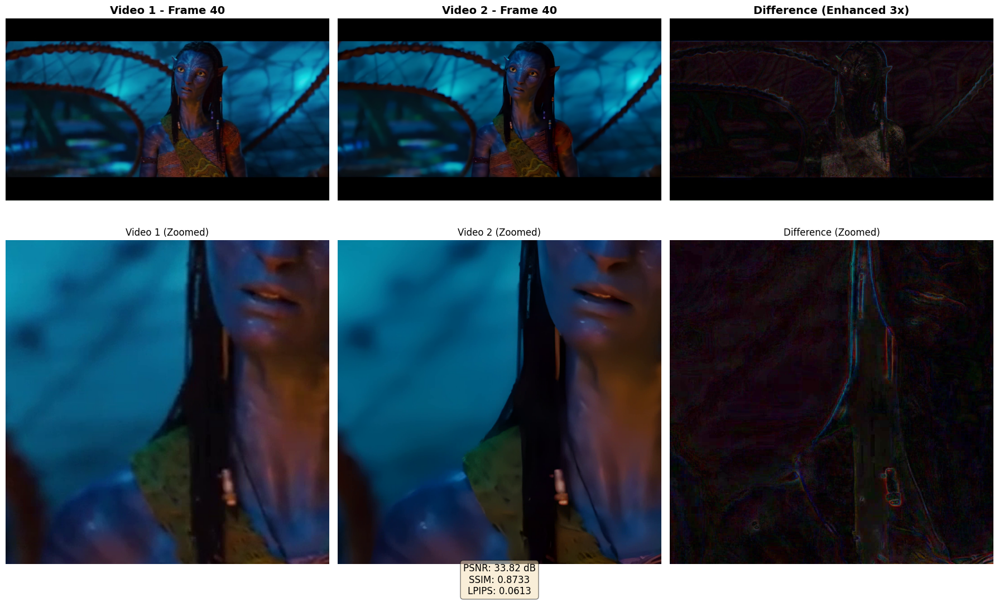

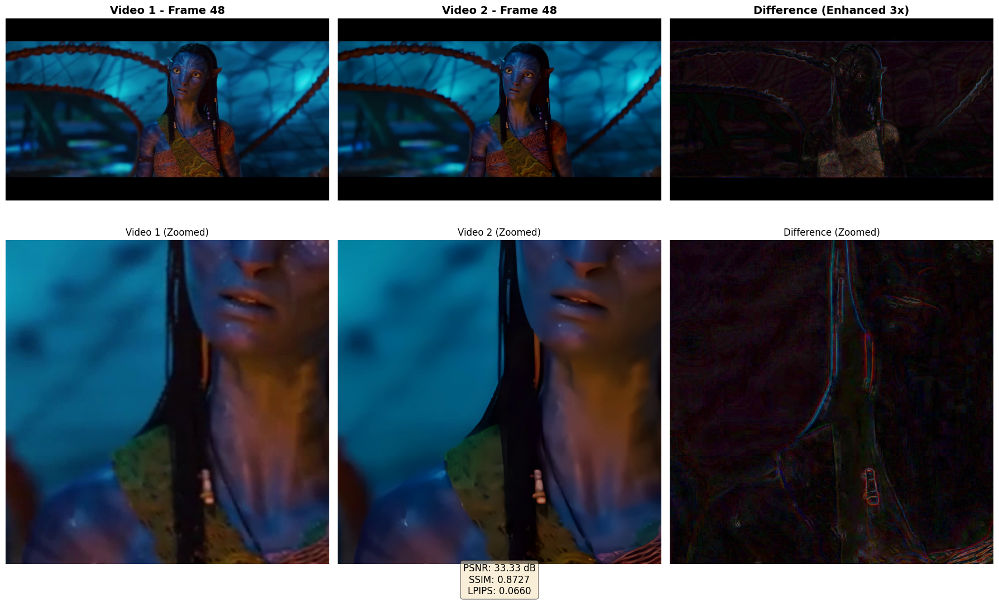


ANALYSIS SUMMARY

Average Metrics:
  PSNR:  35.71 dB  (higher is better, >30dB is good)
  SSIM:  0.8996    (higher is better, max 1.0)
  LPIPS: 0.0630    (lower is better, <0.1 is good)

Interpretation:
  ✓ PSNR: Excellent quality preservation
  ~ SSIM: Moderately similar structure
  ✓ LPIPS: Perceptually very similar

File Sizes:
  Video 1: 3.19 MB
  Video 2: 11.28 MB
  Ratio:   3.53x

Comparison images saved in 'analysis/' folder


In [16]:
# Video Comparison & Analysis Tool
# Compare two videos frame-by-frame with detailed metrics

# Install dependencies
!pip install opencv-python numpy Pillow matplotlib scikit-image lpips torch --quiet

import os
import cv2
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from google.colab import files
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import lpips

# Setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")

# Load LPIPS model for perceptual quality
print("Loading LPIPS model for perceptual quality assessment...")
lpips_model = lpips.LPIPS(net='alex').to(device)
print("Ready!")

# Create directories
os.makedirs('videos', exist_ok=True)
os.makedirs('analysis', exist_ok=True)

# Upload first video
print("\nUpload FIRST video (e.g., original or lower quality)...")
uploaded1 = files.upload()
video1_name = list(uploaded1.keys())[0]
video1_path = f"videos/{video1_name}"
os.rename(video1_name, video1_path)
print(f"Video 1: {video1_name}")

# Upload second video
print("\nUpload SECOND video (e.g., upscaled or higher quality)...")
uploaded2 = files.upload()
video2_name = list(uploaded2.keys())[0]
video2_path = f"videos/{video2_name}"
os.rename(video2_name, video2_path)
print(f"Video 2: {video2_name}")

# Get video info
def get_video_info(path):
    cap = cv2.VideoCapture(path)
    info = {
        'fps': int(cap.get(cv2.CAP_PROP_FPS)),
        'width': int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
        'height': int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
        'frames': int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    }
    cap.release()
    return info

info1 = get_video_info(video1_path)
info2 = get_video_info(video2_path)

print(f"\nVideo 1: {info1['width']}x{info1['height']}, {info1['frames']} frames @ {info1['fps']}fps")
print(f"Video 2: {info2['width']}x{info2['height']}, {info2['frames']} frames @ {info2['fps']}fps")

# Quality metrics calculation
def calculate_metrics(img1, img2):
    # Resize images to same size if different
    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]), interpolation=cv2.INTER_LANCZOS4)

    # PSNR (Peak Signal-to-Noise Ratio) - higher is better
    psnr_value = psnr(img1, img2, data_range=255)

    # SSIM (Structural Similarity Index) - higher is better (max 1.0)
    ssim_value = ssim(img1, img2, channel_axis=2, data_range=255)

    # LPIPS (Learned Perceptual Image Patch Similarity) - lower is better
    img1_tensor = torch.from_numpy(img1).permute(2, 0, 1).unsqueeze(0).float().to(device) / 255.0
    img2_tensor = torch.from_numpy(img2).permute(2, 0, 1).unsqueeze(0).float().to(device) / 255.0

    # Normalize to [-1, 1]
    img1_tensor = img1_tensor * 2 - 1
    img2_tensor = img2_tensor * 2 - 1

    with torch.no_grad():
        lpips_value = lpips_model(img1_tensor, img2_tensor).item()

    return {
        'psnr': psnr_value,
        'ssim': ssim_value,
        'lpips': lpips_value
    }

# Analyze frames
print("\nAnalyzing frames...")
cap1 = cv2.VideoCapture(video1_path)
cap2 = cv2.VideoCapture(video2_path)

# Select frames to analyze
frame_count = min(info1['frames'], info2['frames'])
analysis_frames = [
    frame_count // 10,
    frame_count // 4,
    frame_count // 2,
    3 * frame_count // 4,
    9 * frame_count // 10
]

results = []

for frame_num in analysis_frames:
    cap1.set(cv2.CAP_PROP_POS_FRAMES, frame_num)
    cap2.set(cv2.CAP_PROP_POS_FRAMES, frame_num)

    ret1, frame1 = cap1.read()
    ret2, frame2 = cap2.read()

    if ret1 and ret2:
        # Convert to RGB
        frame1_rgb = cv2.cvtColor(frame1, cv2.COLOR_BGR2RGB)
        frame2_rgb = cv2.cvtColor(frame2, cv2.COLOR_BGR2RGB)

        # Calculate metrics
        metrics = calculate_metrics(frame1_rgb, frame2_rgb)
        results.append({
            'frame': frame_num,
            'metrics': metrics,
            'frame1': frame1_rgb,
            'frame2': frame2_rgb
        })

        print(f"Frame {frame_num}: PSNR={metrics['psnr']:.2f}dB, SSIM={metrics['ssim']:.4f}, LPIPS={metrics['lpips']:.4f}")

cap1.release()
cap2.release()

# Visual comparison
print("\nGenerating visual comparisons...")

for idx, result in enumerate(results):
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))

    frame1 = result['frame1']
    frame2 = result['frame2']

    # Resize for fair comparison
    if frame1.shape != frame2.shape:
        frame1_resized = cv2.resize(frame1, (frame2.shape[1], frame2.shape[0]), interpolation=cv2.INTER_LANCZOS4)
    else:
        frame1_resized = frame1

    # Calculate absolute difference
    diff = np.abs(frame2.astype(float) - frame1_resized.astype(float)).astype(np.uint8)
    diff_enhanced = np.clip(diff * 3, 0, 255).astype(np.uint8)

    # Row 1: Full frames
    axes[0, 0].imshow(frame1_resized)
    axes[0, 0].set_title(f'Video 1 - Frame {result["frame"]}', fontsize=14, fontweight='bold')
    axes[0, 0].axis('off')

    axes[0, 1].imshow(frame2)
    axes[0, 1].set_title(f'Video 2 - Frame {result["frame"]}', fontsize=14, fontweight='bold')
    axes[0, 1].axis('off')

    axes[0, 2].imshow(diff_enhanced)
    axes[0, 2].set_title('Difference (Enhanced 3x)', fontsize=14, fontweight='bold')
    axes[0, 2].axis('off')

    # Row 2: Zoomed center crops
    h, w = frame2.shape[:2]
    crop_size = min(h, w) // 3
    cy, cx = h // 2, w // 2
    y1, y2 = cy - crop_size//2, cy + crop_size//2
    x1, x2 = cx - crop_size//2, cx + crop_size//2

    crop1 = frame1_resized[y1:y2, x1:x2]
    crop2 = frame2[y1:y2, x1:x2]
    crop_diff = diff_enhanced[y1:y2, x1:x2]

    axes[1, 0].imshow(crop1)
    axes[1, 0].set_title('Video 1 (Zoomed)', fontsize=12)
    axes[1, 0].axis('off')

    axes[1, 1].imshow(crop2)
    axes[1, 1].set_title('Video 2 (Zoomed)', fontsize=12)
    axes[1, 1].axis('off')

    axes[1, 2].imshow(crop_diff)
    axes[1, 2].set_title('Difference (Zoomed)', fontsize=12)
    axes[1, 2].axis('off')

    # Add metrics text
    metrics_text = f"PSNR: {result['metrics']['psnr']:.2f} dB\n"
    metrics_text += f"SSIM: {result['metrics']['ssim']:.4f}\n"
    metrics_text += f"LPIPS: {result['metrics']['lpips']:.4f}"

    fig.text(0.5, 0.02, metrics_text, ha='center', fontsize=12,
             bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

    plt.tight_layout(rect=[0, 0.05, 1, 1])
    plt.savefig(f'analysis/comparison_frame_{result["frame"]}.png', dpi=150, bbox_inches='tight')
    plt.show()

# Summary statistics
print("\n" + "="*60)
print("ANALYSIS SUMMARY")
print("="*60)

avg_psnr = np.mean([r['metrics']['psnr'] for r in results])
avg_ssim = np.mean([r['metrics']['ssim'] for r in results])
avg_lpips = np.mean([r['metrics']['lpips'] for r in results])

print(f"\nAverage Metrics:")
print(f"  PSNR:  {avg_psnr:.2f} dB  (higher is better, >30dB is good)")
print(f"  SSIM:  {avg_ssim:.4f}    (higher is better, max 1.0)")
print(f"  LPIPS: {avg_lpips:.4f}    (lower is better, <0.1 is good)")

print(f"\nInterpretation:")
if avg_psnr > 30:
    print("  ✓ PSNR: Excellent quality preservation")
elif avg_psnr > 25:
    print("  ~ PSNR: Good quality with some differences")
else:
    print("  ✗ PSNR: Significant differences detected")

if avg_ssim > 0.95:
    print("  ✓ SSIM: Very similar structure")
elif avg_ssim > 0.85:
    print("  ~ SSIM: Moderately similar structure")
else:
    print("  ✗ SSIM: Different structural characteristics")

if avg_lpips < 0.1:
    print("  ✓ LPIPS: Perceptually very similar")
elif avg_lpips < 0.3:
    print("  ~ LPIPS: Noticeable perceptual differences")
else:
    print("  ✗ LPIPS: Significant perceptual differences")

print(f"\nFile Sizes:")
size1 = os.path.getsize(video1_path) / (1024**2)
size2 = os.path.getsize(video2_path) / (1024**2)
print(f"  Video 1: {size1:.2f} MB")
print(f"  Video 2: {size2:.2f} MB")
print(f"  Ratio:   {size2/size1:.2f}x")

print("\n" + "="*60)
print("Comparison images saved in 'analysis/' folder")
print("="*60)

Project folder: /content/video-super-resolution


Saving Untitled video (1).mp4 to Untitled video (1).mp4
Video ready: Untitled video (1).mp4
Video Information:
   Resolution: 1920x1080
   FPS: 30
   Frames: 54
   Duration: 1s
Starting upscaling...
   Method: LANCZOS
   Scale: ×4
   Input: 1920x1080
   Output: 7680x4320


Processing frames: 100%|██████████| 54/54 [00:52<00:00,  1.03frame/s]


Video saved: /content/video-super-resolution/output/Untitled video (1)_upscaled_4x.mp4


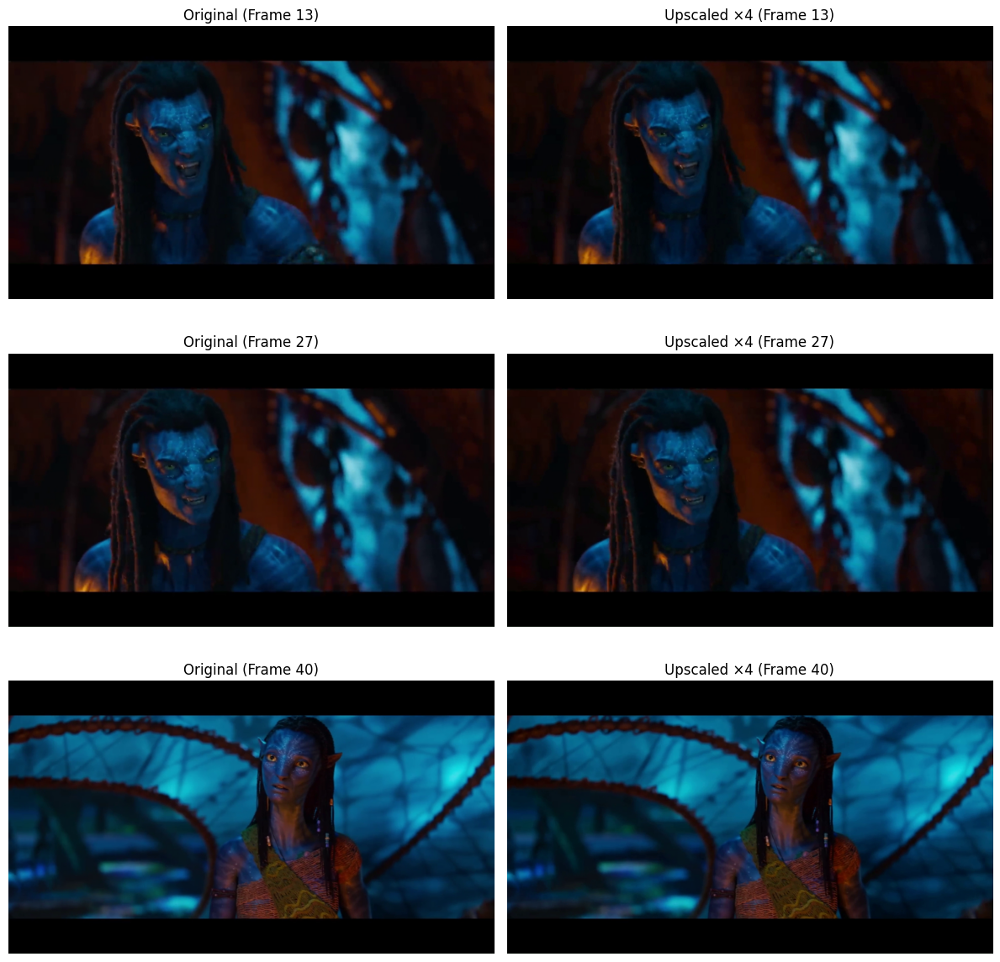

File Size Comparison:
   Original: 3.19 MB
   Upscaled: 12.42 MB
   Ratio: 3.89x


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

All done! Your video has been upscaled successfully.


In [17]:
# ENHANCED VIDEO SUPER-RESOLUTION PIPELINE
# Supports multiple upscaling methods with quality metrics

!pip install torch torchvision opencv-python tqdm Pillow numpy --quiet

import os
import cv2
import torch
import numpy as np
from tqdm import tqdm
from PIL import Image
from google.colab import files
import matplotlib.pyplot as plt
from typing import Tuple, Optional

class Config:
    BASE_DIR = "/content/video-super-resolution"
    INPUT_DIR = f"{BASE_DIR}/input"
    OUTPUT_DIR = f"{BASE_DIR}/output"
    SCALE_FACTOR = 4
    UPSCALE_METHOD = "lanczos"

config = Config()

os.makedirs(config.INPUT_DIR, exist_ok=True)
os.makedirs(config.OUTPUT_DIR, exist_ok=True)
print(f"Project folder: {config.BASE_DIR}")

uploaded = files.upload()
if not uploaded:
    raise ValueError("No file uploaded!")

video_name = list(uploaded.keys())[0]
input_path = f"{config.INPUT_DIR}/{video_name}"
os.rename(video_name, input_path)
print(f"Video ready: {video_name}")

def get_video_info(video_path: str) -> dict:
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise ValueError(f"Cannot open video: {video_path}")

    info = {
        'fps': int(cap.get(cv2.CAP_PROP_FPS)),
        'width': int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
        'height': int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
        'frame_count': int(cap.get(cv2.CAP_PROP_FRAME_COUNT)),
        'duration': int(cap.get(cv2.CAP_PROP_FRAME_COUNT) / cap.get(cv2.CAP_PROP_FPS))
    }
    cap.release()

    print("Video Information:")
    print(f"   Resolution: {info['width']}x{info['height']}")
    print(f"   FPS: {info['fps']}")
    print(f"   Frames: {info['frame_count']}")
    print(f"   Duration: {info['duration']}s")

    return info

video_info = get_video_info(input_path)

class VideoUpscaler:
    @staticmethod
    def upscale_frame(frame: np.ndarray, scale: int, method: str) -> np.ndarray:
        h, w = frame.shape[:2]
        new_size = (w * scale, h * scale)

        if method == 'lanczos':
            pil_img = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            upscaled = pil_img.resize(new_size, Image.LANCZOS)
            return cv2.cvtColor(np.array(upscaled), cv2.COLOR_RGB2BGR)

        elif method == 'bicubic':
            return cv2.resize(frame, new_size, interpolation=cv2.INTER_CUBIC)

        elif method == 'bilinear':
            return cv2.resize(frame, new_size, interpolation=cv2.INTER_LINEAR)

        else:
            raise ValueError(f"Unknown method: {method}")

    @staticmethod
    def process_video(input_path: str,
                     output_path: str,
                     scale: int = 4,
                     method: str = 'lanczos',
                     quality: int = 95) -> None:
        cap = cv2.VideoCapture(input_path)
        if not cap.isOpened():
            raise ValueError("Cannot open input video")

        fps = int(cap.get(cv2.CAP_PROP_FPS))
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

        out_width, out_height = width * scale, height * scale
        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(output_path, fourcc, fps, (out_width, out_height))

        print(f"Starting upscaling...")
        print(f"   Method: {method.upper()}")
        print(f"   Scale: ×{scale}")
        print(f"   Input: {width}x{height}")
        print(f"   Output: {out_width}x{out_height}")

        with tqdm(total=frame_count, desc="Processing frames", unit="frame") as pbar:
            while True:
                ret, frame = cap.read()
                if not ret:
                    break
                upscaled = VideoUpscaler.upscale_frame(frame, scale, method)
                out.write(upscaled)
                pbar.update(1)

        cap.release()
        out.release()
        print(f"Video saved: {output_path}")

output_name = f"{os.path.splitext(video_name)[0]}_upscaled_{config.SCALE_FACTOR}x.mp4"
output_path = f"{config.OUTPUT_DIR}/{output_name}"

upscaler = VideoUpscaler()
upscaler.process_video(
    input_path=input_path,
    output_path=output_path,
    scale=config.SCALE_FACTOR,
    method=config.UPSCALE_METHOD
)

def compare_frames(original_path: str,
                  upscaled_path: str,
                  frame_indices: list = [10, 50, 100]) -> None:
    cap_orig = cv2.VideoCapture(original_path)
    cap_upsc = cv2.VideoCapture(upscaled_path)

    fig, axes = plt.subplots(len(frame_indices), 2, figsize=(12, 4*len(frame_indices)))
    if len(frame_indices) == 1:
        axes = [axes]

    for idx, frame_id in enumerate(frame_indices):
        cap_orig.set(cv2.CAP_PROP_POS_FRAMES, frame_id)
        cap_upsc.set(cv2.CAP_PROP_POS_FRAMES, frame_id)

        ret1, frame1 = cap_orig.read()
        ret2, frame2 = cap_upsc.read()

        if ret1 and ret2:
            h, w = frame2.shape[:2]
            frame1_resized = cv2.resize(frame1, (w, h), interpolation=cv2.INTER_LANCZOS4)

            axes[idx][0].imshow(cv2.cvtColor(frame1_resized, cv2.COLOR_BGR2RGB))
            axes[idx][0].set_title(f"Original (Frame {frame_id})")
            axes[idx][0].axis('off')

            axes[idx][1].imshow(cv2.cvtColor(frame2, cv2.COLOR_BGR2RGB))
            axes[idx][1].set_title(f"Upscaled ×{config.SCALE_FACTOR} (Frame {frame_id})")
            axes[idx][1].axis('off')

    cap_orig.release()
    cap_upsc.release()
    plt.tight_layout()
    plt.show()

frame_samples = [
    video_info['frame_count'] // 4,
    video_info['frame_count'] // 2,
    3 * video_info['frame_count'] // 4
]
compare_frames(input_path, output_path, frame_samples[:min(3, video_info['frame_count'])])

orig_size = os.path.getsize(input_path) / (1024 * 1024)
upsc_size = os.path.getsize(output_path) / (1024 * 1024)

print(f"File Size Comparison:")
print(f"   Original: {orig_size:.2f} MB")
print(f"   Upscaled: {upsc_size:.2f} MB")
print(f"   Ratio: {upsc_size/orig_size:.2f}x")

files.download(output_path)
print("All done! Your video has been upscaled successfully.")


Device: cuda
Loading LPIPS model for perceptual quality assessment...
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.12/dist-packages/lpips/weights/v0.1/alex.pth
Ready!

Upload FIRST video (e.g., original or lower quality)...


Saving Untitled video (1).mp4 to Untitled video (1).mp4
Video 1: Untitled video (1).mp4

Upload SECOND video (e.g., upscaled or higher quality)...


Saving Untitled video (1)_realesrgan_4x.mp4 to Untitled video (1)_realesrgan_4x.mp4
Video 2: Untitled video (1)_realesrgan_4x.mp4

Upload THIRD video (e.g., another upscale method or reference)...


Saving Untitled video (1)_upscaled_4x (2).mp4 to Untitled video (1)_upscaled_4x (2).mp4
Video 3: Untitled video (1)_upscaled_4x (2).mp4

Video 1: 1920x1080, 54 frames @ 30fps
Video 2: 7680x4320, 54 frames @ 30fps
Video 3: 7680x4320, 54 frames @ 30fps

Analyzing frames...
Frame 5:
  Video 2: PSNR=37.02dB, SSIM=0.9144, LPIPS=0.0629
  Video 3: PSNR=41.44dB, SSIM=0.9582, LPIPS=0.0156
Frame 13:
  Video 2: PSNR=37.33dB, SSIM=0.9185, LPIPS=0.0593
  Video 3: PSNR=41.67dB, SSIM=0.9600, LPIPS=0.0152
Frame 27:
  Video 2: PSNR=37.05dB, SSIM=0.9191, LPIPS=0.0654
  Video 3: PSNR=41.44dB, SSIM=0.9598, LPIPS=0.0143
Frame 40:
  Video 2: PSNR=33.82dB, SSIM=0.8733, LPIPS=0.0613
  Video 3: PSNR=41.40dB, SSIM=0.9654, LPIPS=0.0076
Frame 48:
  Video 2: PSNR=33.33dB, SSIM=0.8727, LPIPS=0.0660
  Video 3: PSNR=41.92dB, SSIM=0.9715, LPIPS=0.0056

Generating visual comparisons...


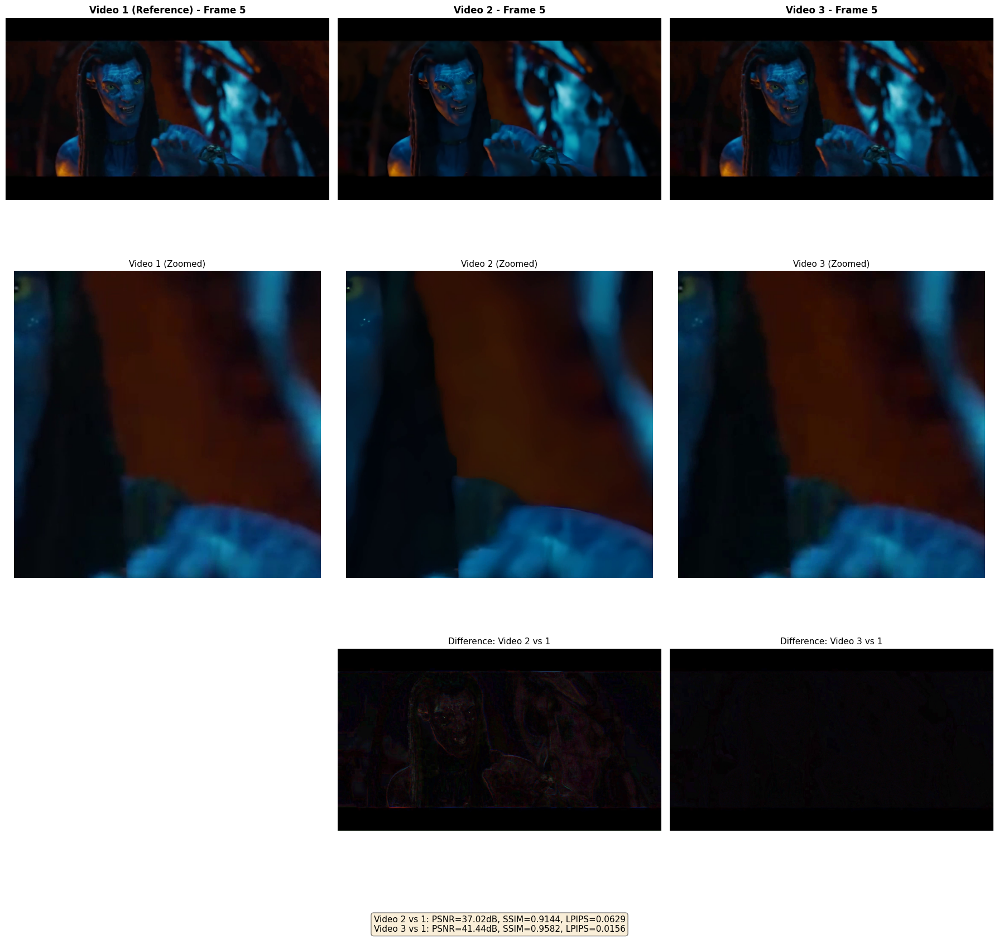

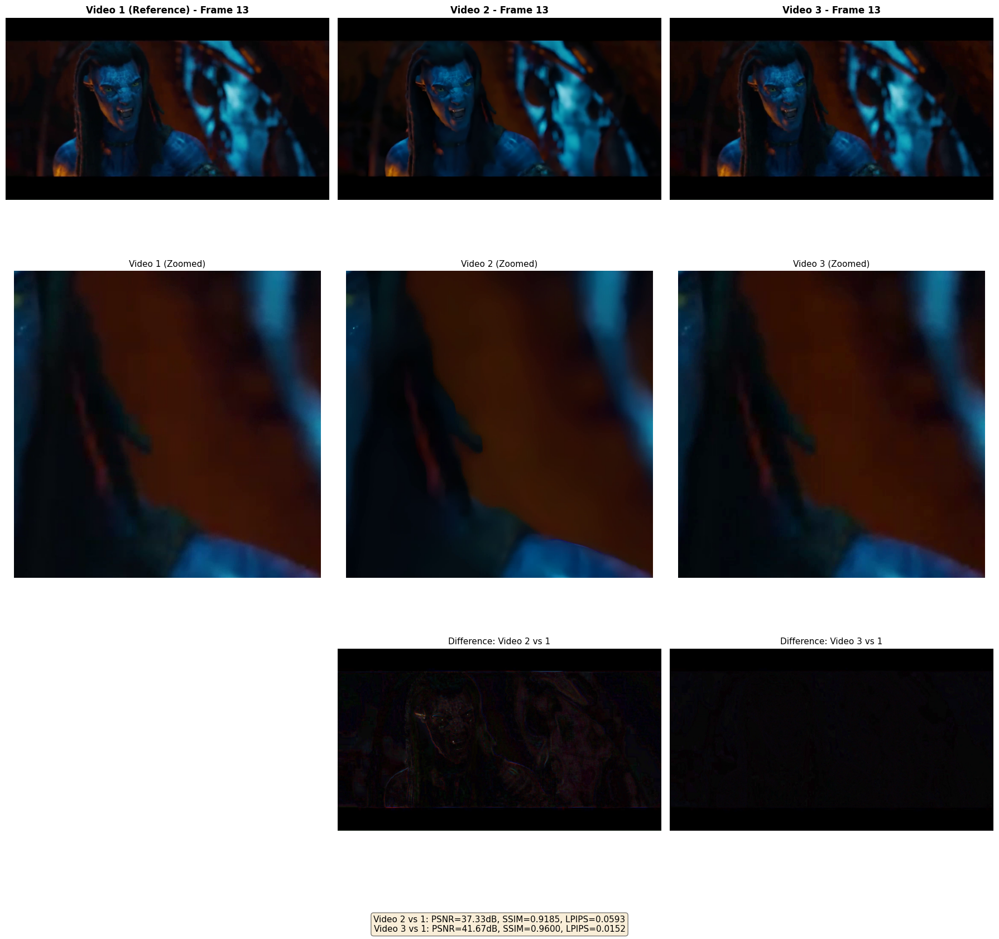

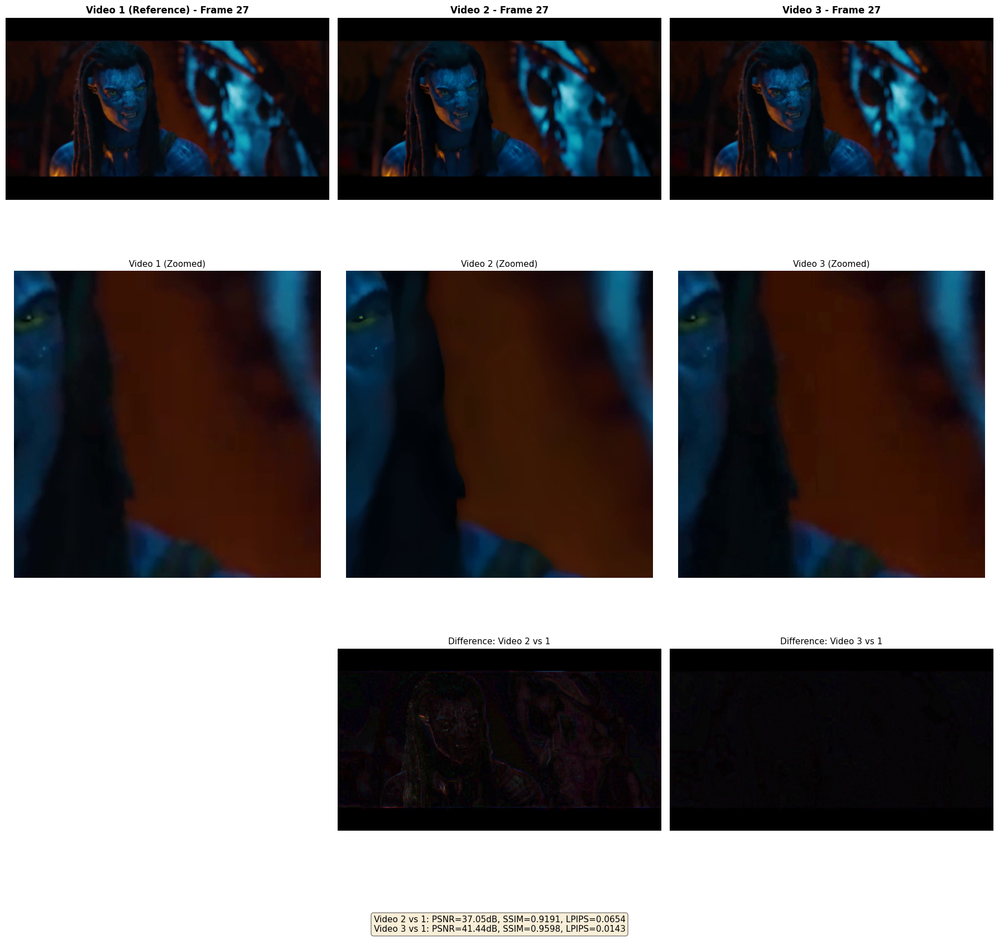

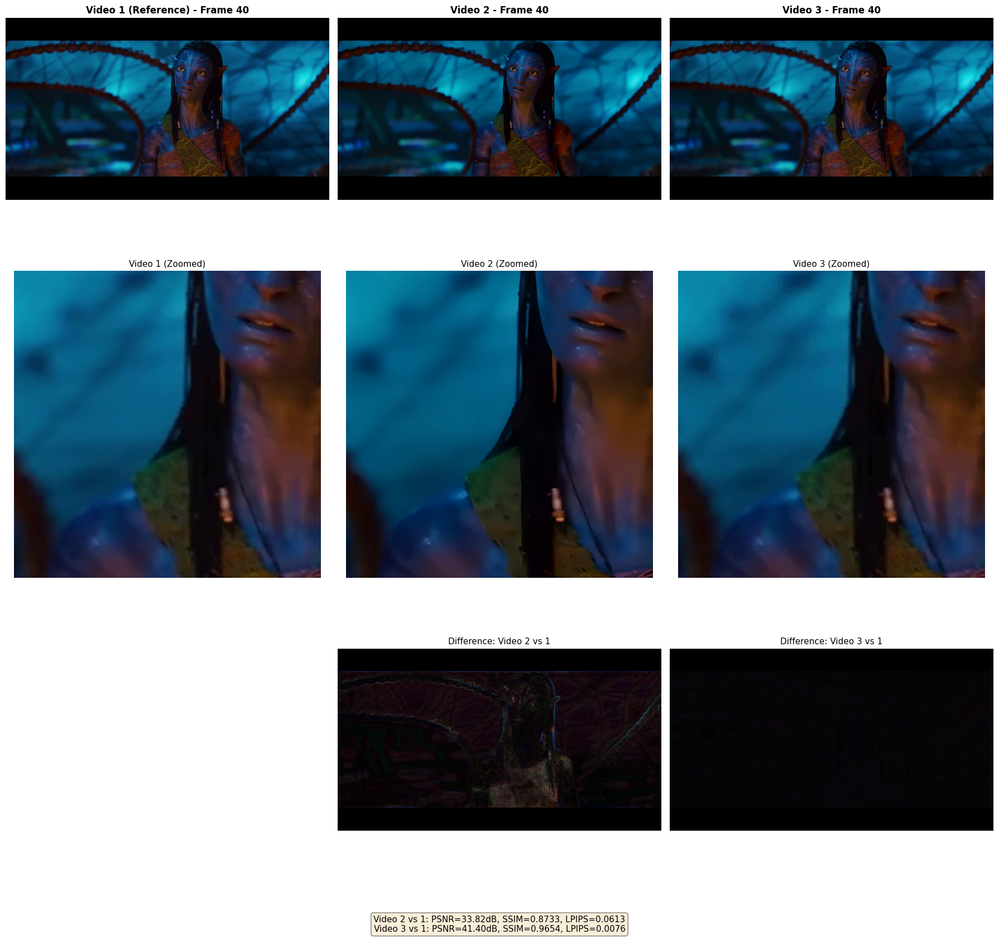

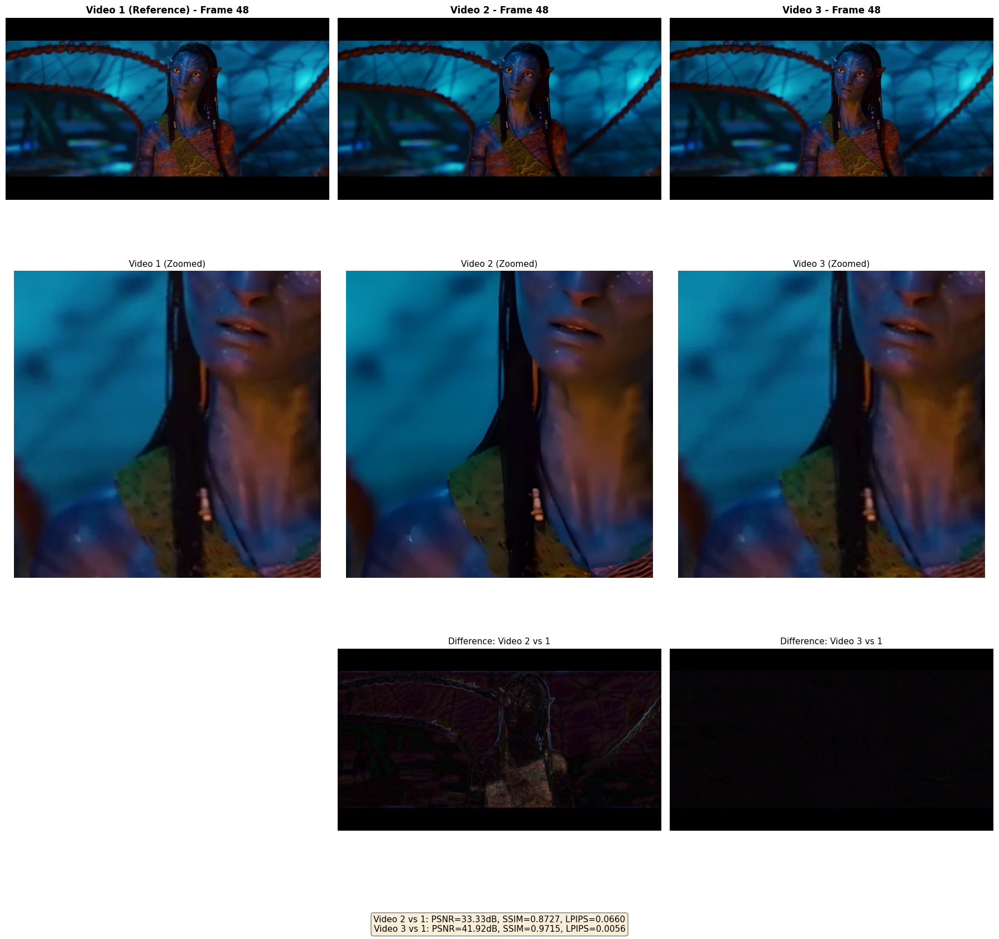


ANALYSIS SUMMARY

Video 2 vs Video 1 (Reference):
  PSNR:  35.71 dB  (higher is better, >30dB is good)
  SSIM:  0.8996    (higher is better, max 1.0)
  LPIPS: 0.0630    (lower is better, <0.1 is good)

Video 3 vs Video 1 (Reference):
  PSNR:  41.57 dB  (higher is better, >30dB is good)
  SSIM:  0.9630    (higher is better, max 1.0)
  LPIPS: 0.0117    (lower is better, <0.1 is good)

Comparison (Video 2 vs Video 3):
  ✓ Video 3 has better PSNR (+5.86dB)
  ✓ Video 3 has better SSIM (+0.0634)
  ✓ Video 3 has better LPIPS (-0.0513)

Overall Winner:
  🏆 Video 3 wins (3/3 metrics)

File Sizes:
  Video 1: 3.19 MB
  Video 2: 11.28 MB (ratio: 3.53x)
  Video 3: 12.42 MB (ratio: 3.89x)

Comparison images saved in 'analysis/' folder


In [18]:
# Video Comparison & Analysis Tool
# Compare two videos frame-by-frame with detailed metrics

# Install dependencies
!pip install opencv-python numpy Pillow matplotlib scikit-image lpips torch --quiet

import os
import cv2
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from google.colab import files
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import lpips

# Setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")

# Load LPIPS model for perceptual quality
print("Loading LPIPS model for perceptual quality assessment...")
lpips_model = lpips.LPIPS(net='alex').to(device)
print("Ready!")

# Create directories
os.makedirs('videos', exist_ok=True)
os.makedirs('analysis', exist_ok=True)

# Upload first video
print("\nUpload FIRST video (e.g., original or lower quality)...")
uploaded1 = files.upload()
video1_name = list(uploaded1.keys())[0]
video1_path = f"videos/{video1_name}"
os.rename(video1_name, video1_path)
print(f"Video 1: {video1_name}")

# Upload second video
print("\nUpload SECOND video (e.g., upscaled or higher quality)...")
uploaded2 = files.upload()
video2_name = list(uploaded2.keys())[0]
video2_path = f"videos/{video2_name}"
os.rename(video2_name, video2_path)
print(f"Video 2: {video2_name}")

# Upload third video
print("\nUpload THIRD video (e.g., another upscale method or reference)...")
uploaded3 = files.upload()
video3_name = list(uploaded3.keys())[0]
video3_path = f"videos/{video3_name}"
os.rename(video3_name, video3_path)
print(f"Video 3: {video3_name}")

# Get video info
def get_video_info(path):
    cap = cv2.VideoCapture(path)
    info = {
        'fps': int(cap.get(cv2.CAP_PROP_FPS)),
        'width': int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
        'height': int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
        'frames': int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    }
    cap.release()
    return info

info1 = get_video_info(video1_path)
info2 = get_video_info(video2_path)
info3 = get_video_info(video3_path)

print(f"\nVideo 1: {info1['width']}x{info1['height']}, {info1['frames']} frames @ {info1['fps']}fps")
print(f"Video 2: {info2['width']}x{info2['height']}, {info2['frames']} frames @ {info2['fps']}fps")
print(f"Video 3: {info3['width']}x{info3['height']}, {info3['frames']} frames @ {info3['fps']}fps")

# Quality metrics calculation
def calculate_metrics(img1, img2):
    # Resize images to same size if different
    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]), interpolation=cv2.INTER_LANCZOS4)

    # PSNR (Peak Signal-to-Noise Ratio) - higher is better
    psnr_value = psnr(img1, img2, data_range=255)

    # SSIM (Structural Similarity Index) - higher is better (max 1.0)
    ssim_value = ssim(img1, img2, channel_axis=2, data_range=255)

    # LPIPS (Learned Perceptual Image Patch Similarity) - lower is better
    img1_tensor = torch.from_numpy(img1).permute(2, 0, 1).unsqueeze(0).float().to(device) / 255.0
    img2_tensor = torch.from_numpy(img2).permute(2, 0, 1).unsqueeze(0).float().to(device) / 255.0

    # Normalize to [-1, 1]
    img1_tensor = img1_tensor * 2 - 1
    img2_tensor = img2_tensor * 2 - 1

    with torch.no_grad():
        lpips_value = lpips_model(img1_tensor, img2_tensor).item()

    return {
        'psnr': psnr_value,
        'ssim': ssim_value,
        'lpips': lpips_value
    }

# Analyze frames
print("\nAnalyzing frames...")
cap1 = cv2.VideoCapture(video1_path)
cap2 = cv2.VideoCapture(video2_path)
cap3 = cv2.VideoCapture(video3_path)

# Select frames to analyze
frame_count = min(info1['frames'], info2['frames'], info3['frames'])
analysis_frames = [
    frame_count // 10,
    frame_count // 4,
    frame_count // 2,
    3 * frame_count // 4,
    9 * frame_count // 10
]

results = []

for frame_num in analysis_frames:
    cap1.set(cv2.CAP_PROP_POS_FRAMES, frame_num)
    cap2.set(cv2.CAP_PROP_POS_FRAMES, frame_num)
    cap3.set(cv2.CAP_PROP_POS_FRAMES, frame_num)

    ret1, frame1 = cap1.read()
    ret2, frame2 = cap2.read()
    ret3, frame3 = cap3.read()

    if ret1 and ret2 and ret3:
        # Convert to RGB
        frame1_rgb = cv2.cvtColor(frame1, cv2.COLOR_BGR2RGB)
        frame2_rgb = cv2.cvtColor(frame2, cv2.COLOR_BGR2RGB)
        frame3_rgb = cv2.cvtColor(frame3, cv2.COLOR_BGR2RGB)

        # Calculate metrics (comparing video 2 and 3 against video 1)
        metrics2 = calculate_metrics(frame1_rgb, frame2_rgb)
        metrics3 = calculate_metrics(frame1_rgb, frame3_rgb)

        results.append({
            'frame': frame_num,
            'metrics2': metrics2,
            'metrics3': metrics3,
            'frame1': frame1_rgb,
            'frame2': frame2_rgb,
            'frame3': frame3_rgb
        })

        print(f"Frame {frame_num}:")
        print(f"  Video 2: PSNR={metrics2['psnr']:.2f}dB, SSIM={metrics2['ssim']:.4f}, LPIPS={metrics2['lpips']:.4f}")
        print(f"  Video 3: PSNR={metrics3['psnr']:.2f}dB, SSIM={metrics3['ssim']:.4f}, LPIPS={metrics3['lpips']:.4f}")

cap1.release()
cap2.release()
cap3.release()

# Visual comparison
print("\nGenerating visual comparisons...")

for idx, result in enumerate(results):
    fig, axes = plt.subplots(3, 3, figsize=(18, 18))

    frame1 = result['frame1']
    frame2 = result['frame2']
    frame3 = result['frame3']

    # Resize for fair comparison (use largest resolution as reference)
    max_h = max(frame1.shape[0], frame2.shape[0], frame3.shape[0])
    max_w = max(frame1.shape[1], frame2.shape[1], frame3.shape[1])

    if frame1.shape != (max_h, max_w, 3):
        frame1_resized = cv2.resize(frame1, (max_w, max_h), interpolation=cv2.INTER_LANCZOS4)
    else:
        frame1_resized = frame1

    if frame2.shape != (max_h, max_w, 3):
        frame2_resized = cv2.resize(frame2, (max_w, max_h), interpolation=cv2.INTER_LANCZOS4)
    else:
        frame2_resized = frame2

    if frame3.shape != (max_h, max_w, 3):
        frame3_resized = cv2.resize(frame3, (max_w, max_h), interpolation=cv2.INTER_LANCZOS4)
    else:
        frame3_resized = frame3

    # Calculate differences
    diff2 = np.abs(frame2_resized.astype(float) - frame1_resized.astype(float)).astype(np.uint8)
    diff3 = np.abs(frame3_resized.astype(float) - frame1_resized.astype(float)).astype(np.uint8)
    diff2_enhanced = np.clip(diff2 * 3, 0, 255).astype(np.uint8)
    diff3_enhanced = np.clip(diff3 * 3, 0, 255).astype(np.uint8)

    # Row 1: Full frames
    axes[0, 0].imshow(frame1_resized)
    axes[0, 0].set_title(f'Video 1 (Reference) - Frame {result["frame"]}', fontsize=12, fontweight='bold')
    axes[0, 0].axis('off')

    axes[0, 1].imshow(frame2_resized)
    axes[0, 1].set_title(f'Video 2 - Frame {result["frame"]}', fontsize=12, fontweight='bold')
    axes[0, 1].axis('off')

    axes[0, 2].imshow(frame3_resized)
    axes[0, 2].set_title(f'Video 3 - Frame {result["frame"]}', fontsize=12, fontweight='bold')
    axes[0, 2].axis('off')

    # Row 2: Zoomed center crops
    h, w = max_h, max_w
    crop_size = min(h, w) // 3
    cy, cx = h // 2, w // 2
    y1, y2 = cy - crop_size//2, cy + crop_size//2
    x1, x2 = cx - crop_size//2, cx + crop_size//2

    crop1 = frame1_resized[y1:y2, x1:x2]
    crop2 = frame2_resized[y1:y2, x1:x2]
    crop3 = frame3_resized[y1:y2, x1:x2]

    axes[1, 0].imshow(crop1)
    axes[1, 0].set_title('Video 1 (Zoomed)', fontsize=11)
    axes[1, 0].axis('off')

    axes[1, 1].imshow(crop2)
    axes[1, 1].set_title('Video 2 (Zoomed)', fontsize=11)
    axes[1, 1].axis('off')

    axes[1, 2].imshow(crop3)
    axes[1, 2].set_title('Video 3 (Zoomed)', fontsize=11)
    axes[1, 2].axis('off')

    # Row 3: Difference maps
    axes[2, 0].axis('off')  # Empty cell

    axes[2, 1].imshow(diff2_enhanced)
    axes[2, 1].set_title('Difference: Video 2 vs 1', fontsize=11)
    axes[2, 1].axis('off')

    axes[2, 2].imshow(diff3_enhanced)
    axes[2, 2].set_title('Difference: Video 3 vs 1', fontsize=11)
    axes[2, 2].axis('off')

    # Add metrics text
    metrics_text = f"Video 2 vs 1: PSNR={result['metrics2']['psnr']:.2f}dB, SSIM={result['metrics2']['ssim']:.4f}, LPIPS={result['metrics2']['lpips']:.4f}\n"
    metrics_text += f"Video 3 vs 1: PSNR={result['metrics3']['psnr']:.2f}dB, SSIM={result['metrics3']['ssim']:.4f}, LPIPS={result['metrics3']['lpips']:.4f}"

    fig.text(0.5, 0.02, metrics_text, ha='center', fontsize=11,
             bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

    plt.tight_layout(rect=[0, 0.05, 1, 1])
    plt.savefig(f'analysis/comparison_frame_{result["frame"]}.png', dpi=150, bbox_inches='tight')
    plt.show()

# Summary statistics
print("\n" + "="*70)
print("ANALYSIS SUMMARY")
print("="*70)

avg_psnr2 = np.mean([r['metrics2']['psnr'] for r in results])
avg_ssim2 = np.mean([r['metrics2']['ssim'] for r in results])
avg_lpips2 = np.mean([r['metrics2']['lpips'] for r in results])

avg_psnr3 = np.mean([r['metrics3']['psnr'] for r in results])
avg_ssim3 = np.mean([r['metrics3']['ssim'] for r in results])
avg_lpips3 = np.mean([r['metrics3']['lpips'] for r in results])

print(f"\nVideo 2 vs Video 1 (Reference):")
print(f"  PSNR:  {avg_psnr2:.2f} dB  (higher is better, >30dB is good)")
print(f"  SSIM:  {avg_ssim2:.4f}    (higher is better, max 1.0)")
print(f"  LPIPS: {avg_lpips2:.4f}    (lower is better, <0.1 is good)")

print(f"\nVideo 3 vs Video 1 (Reference):")
print(f"  PSNR:  {avg_psnr3:.2f} dB  (higher is better, >30dB is good)")
print(f"  SSIM:  {avg_ssim3:.4f}    (higher is better, max 1.0)")
print(f"  LPIPS: {avg_lpips3:.4f}    (lower is better, <0.1 is good)")

print(f"\nComparison (Video 2 vs Video 3):")
if avg_psnr2 > avg_psnr3:
    print(f"  ✓ Video 2 has better PSNR (+{avg_psnr2-avg_psnr3:.2f}dB)")
else:
    print(f"  ✓ Video 3 has better PSNR (+{avg_psnr3-avg_psnr2:.2f}dB)")

if avg_ssim2 > avg_ssim3:
    print(f"  ✓ Video 2 has better SSIM (+{avg_ssim2-avg_ssim3:.4f})")
else:
    print(f"  ✓ Video 3 has better SSIM (+{avg_ssim3-avg_ssim2:.4f})")

if avg_lpips2 < avg_lpips3:
    print(f"  ✓ Video 2 has better LPIPS (-{avg_lpips3-avg_lpips2:.4f})")
else:
    print(f"  ✓ Video 3 has better LPIPS (-{avg_lpips2-avg_lpips3:.4f})")

print(f"\nOverall Winner:")
score2 = sum([avg_psnr2 > avg_psnr3, avg_ssim2 > avg_ssim3, avg_lpips2 < avg_lpips3])
score3 = sum([avg_psnr3 > avg_psnr2, avg_ssim3 > avg_ssim2, avg_lpips3 < avg_lpips2])

if score2 > score3:
    print(f"  🏆 Video 2 wins ({score2}/3 metrics)")
elif score3 > score2:
    print(f"  🏆 Video 3 wins ({score3}/3 metrics)")
else:
    print(f"  🤝 Tie ({score2}/3 each)")

print(f"\nFile Sizes:")
size1 = os.path.getsize(video1_path) / (1024**2)
size2 = os.path.getsize(video2_path) / (1024**2)
size3 = os.path.getsize(video3_path) / (1024**2)
print(f"  Video 1: {size1:.2f} MB")
print(f"  Video 2: {size2:.2f} MB (ratio: {size2/size1:.2f}x)")
print(f"  Video 3: {size3:.2f} MB (ratio: {size3/size1:.2f}x)")

print("\n" + "="*70)
print("Comparison images saved in 'analysis/' folder")
print("="*70)